# Neural Style Transfer in Pytorch

Original Paper: A Neural Algorithm of Artistic Style
https://arxiv.org/abs/1508.06576

In [ ]:
import numpy as np
import torch
import torchvision.transforms.functional as tt
import torch.nn as nn
import torch.optim
from torchvision import transforms
from torch.autograd import Variable
import matplotlib.pyplot as plt
from torch.optim.lbfgs import LBFGS


from PIL import Image
torch.manual_seed(43)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = torch.hub.load('pytorch/vision:v0.6.0', 'vgg16', pretrained=True)
model.cuda()
print(device)
params = list(model.features)

for p in params:
    print(p)

Using cache found in /root/.cache/torch/hub/pytorch_vision_v0.6.0


cuda
Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace=True)
Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
ReLU(inplace

In [ ]:
model_conv1 = model.features[0:1]
model_conv2 = model.features[0:3]
model_conv3 = model.features[0:6]
model_conv4 = model.features[0:8]
model_conv5 = model.features[0:11]


#print(model_conv1.weight)




iteration  0


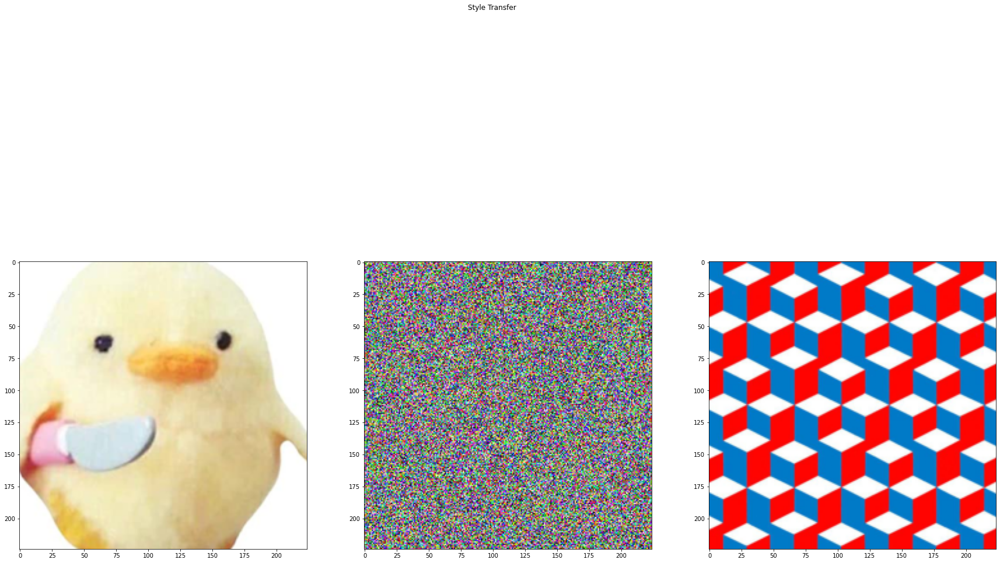

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  10


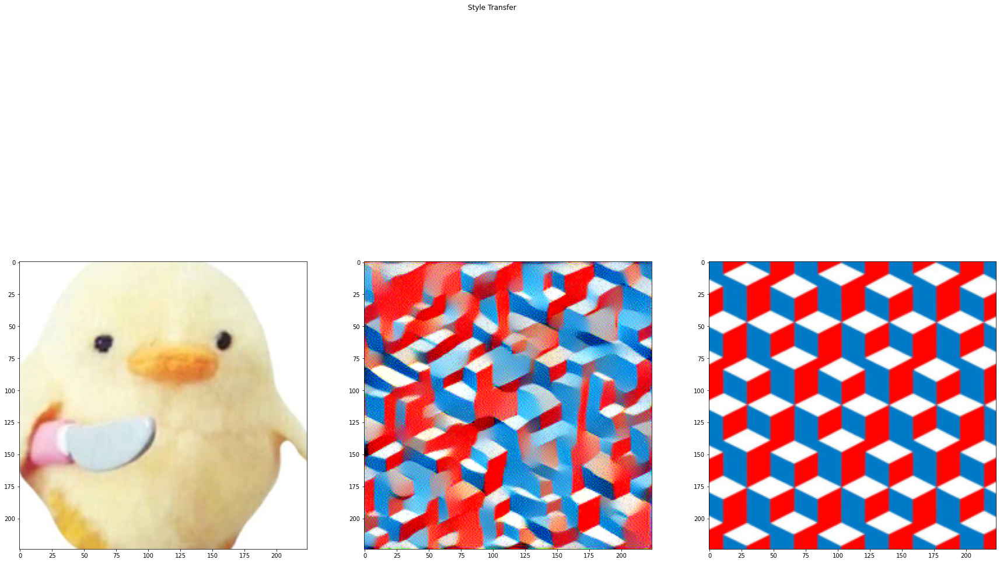

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  20


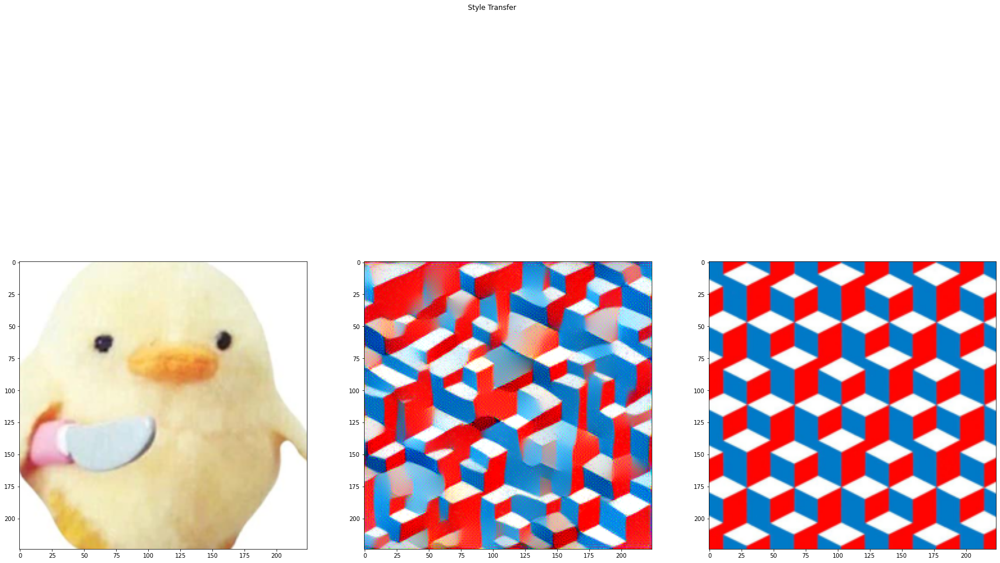

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  30


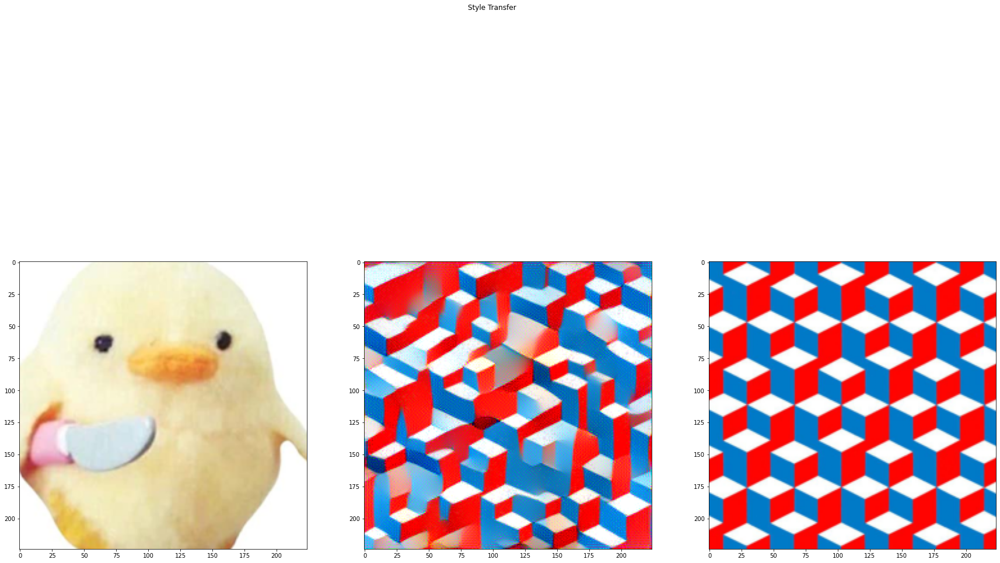

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  40


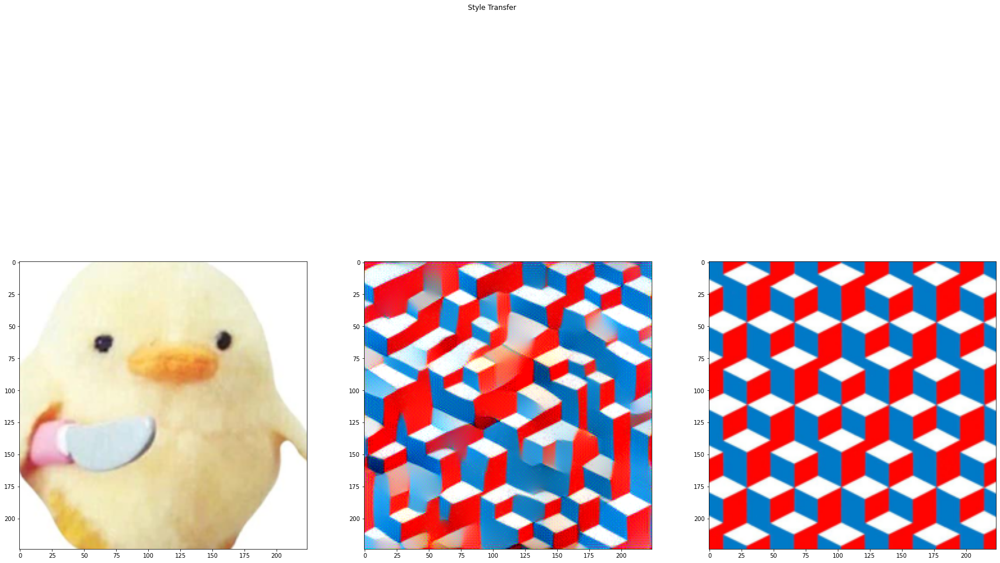

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  50


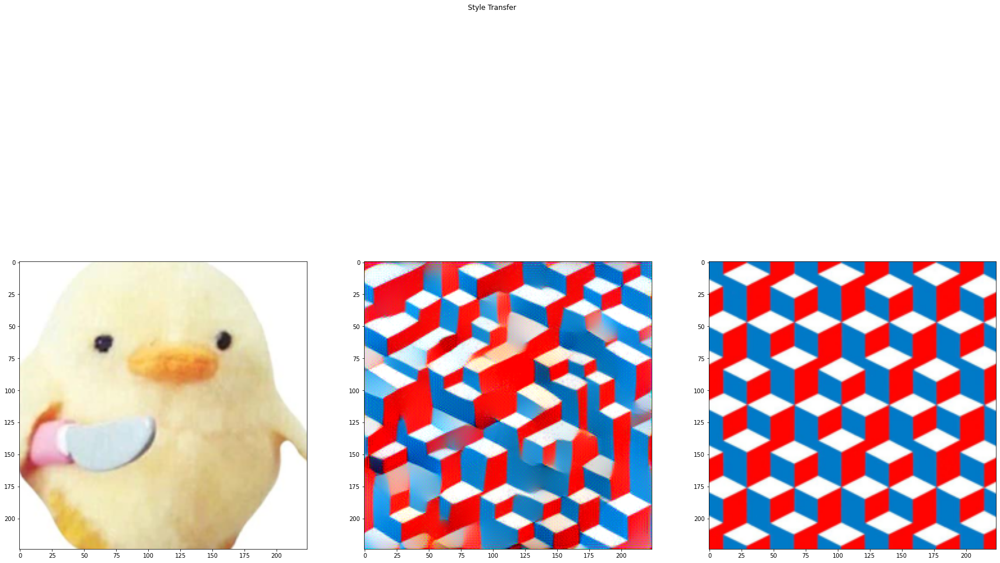

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  60


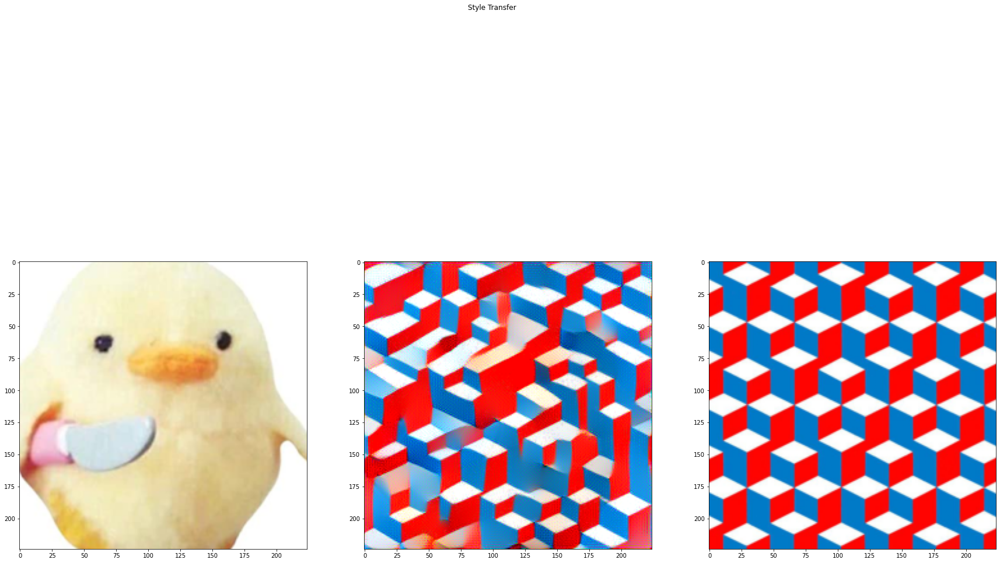

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  70


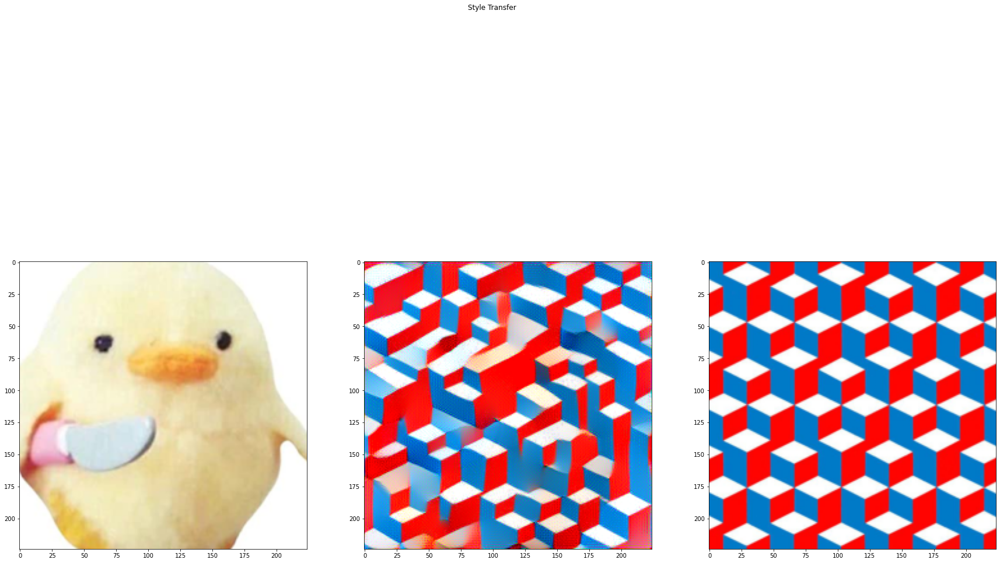

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  80


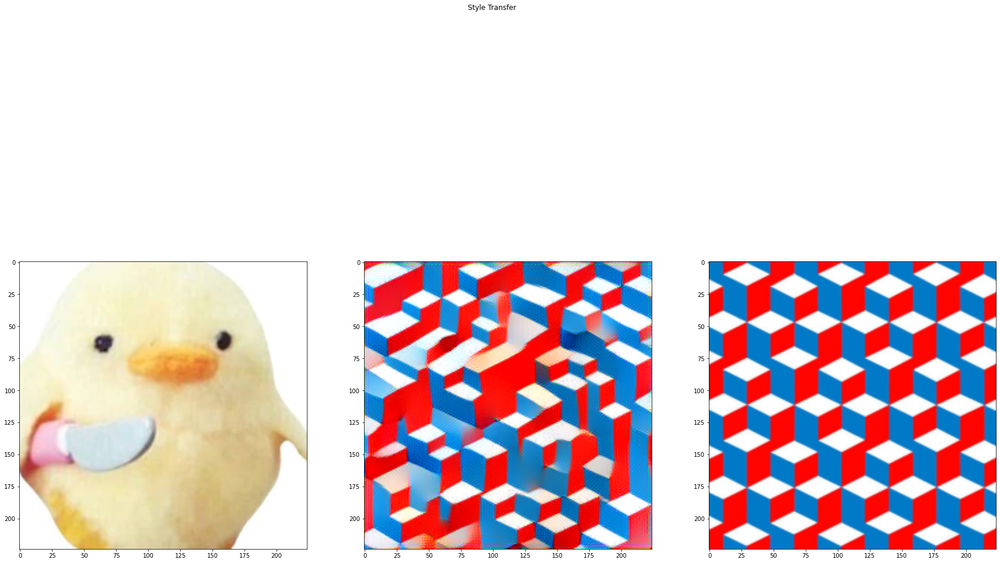

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  90


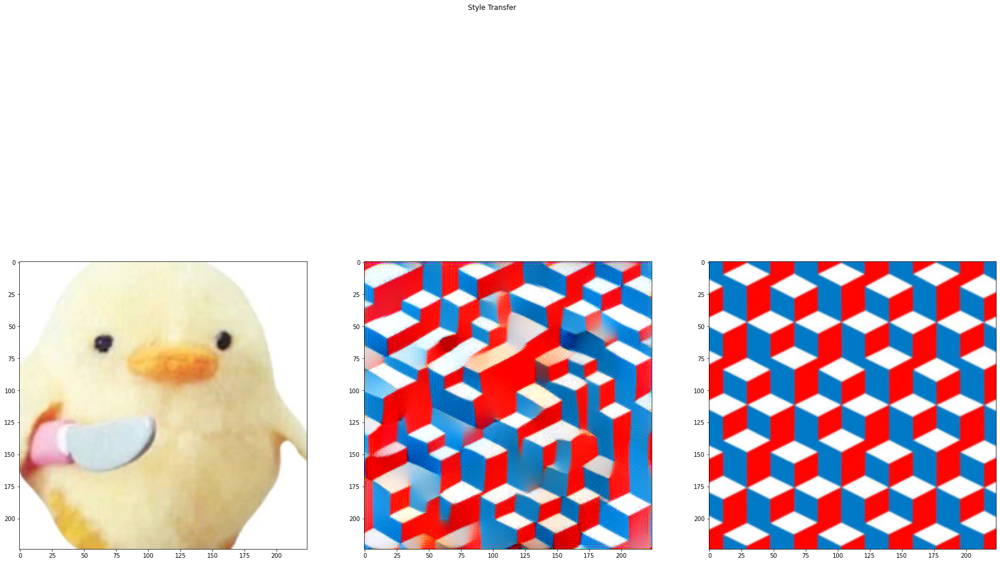

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  100


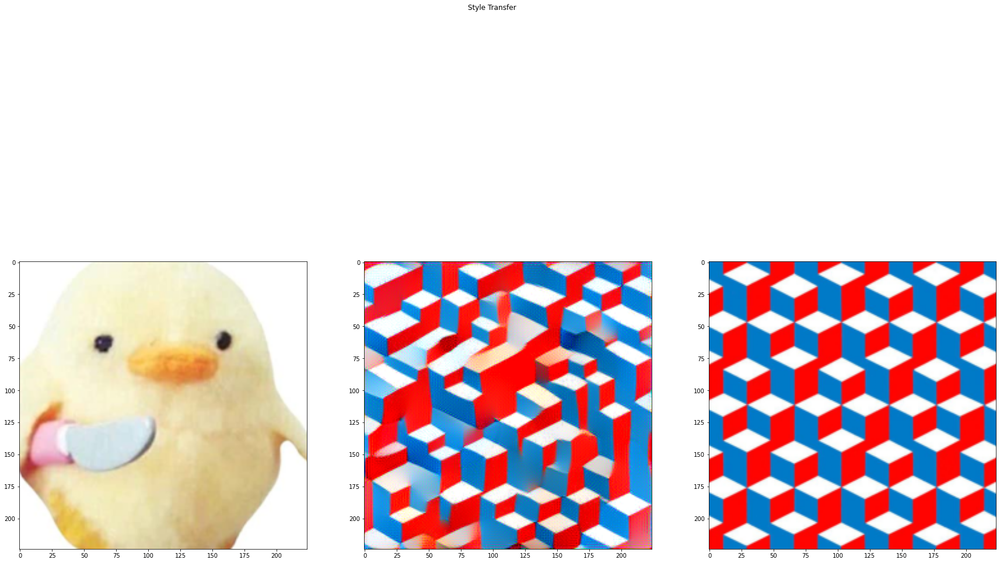

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  110


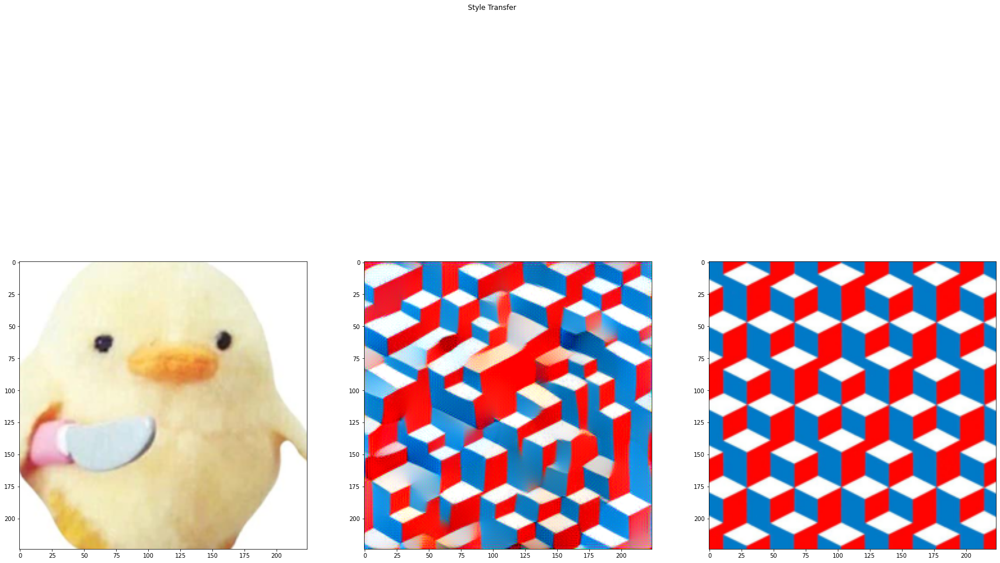

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  120


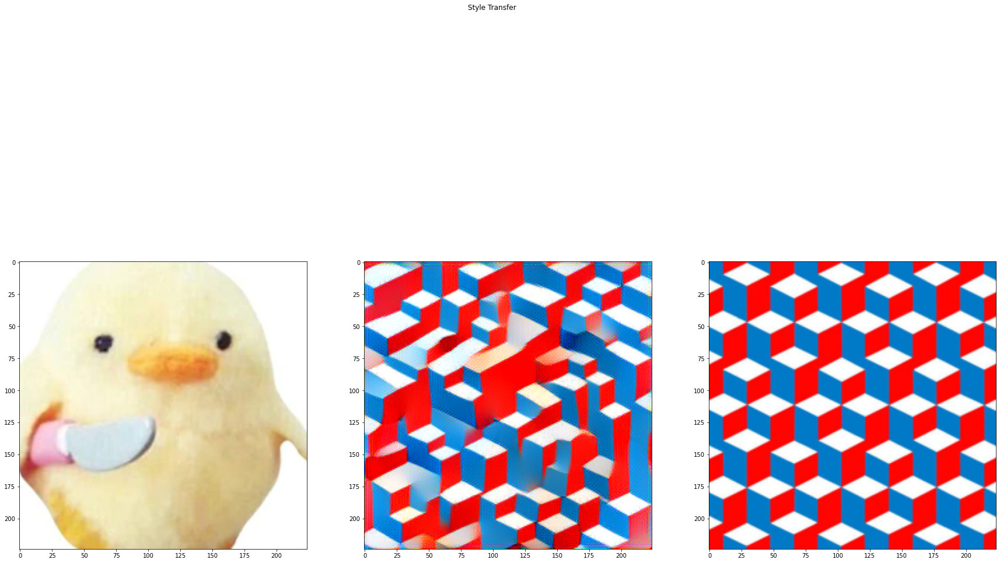

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  130


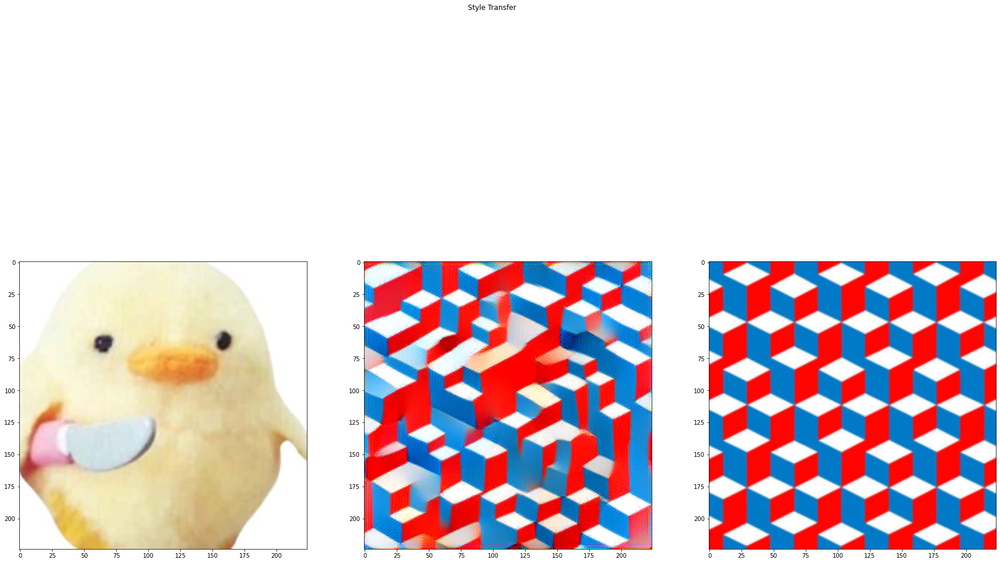

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  140


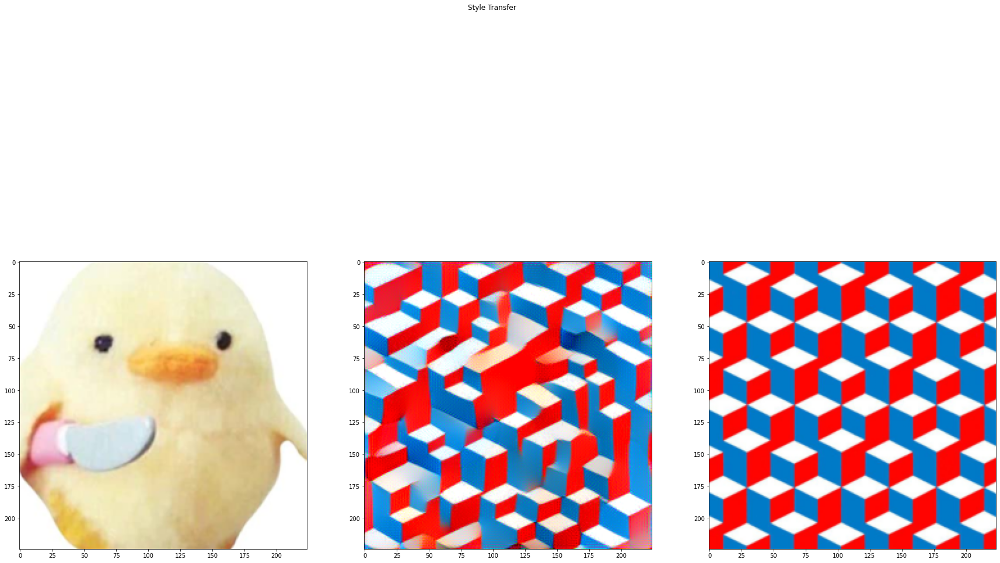

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  150


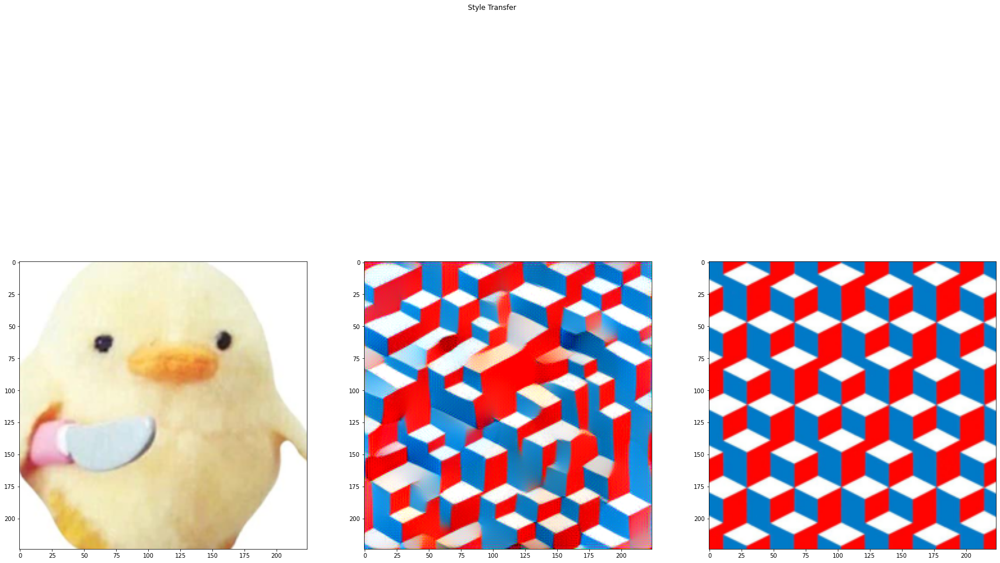

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  160


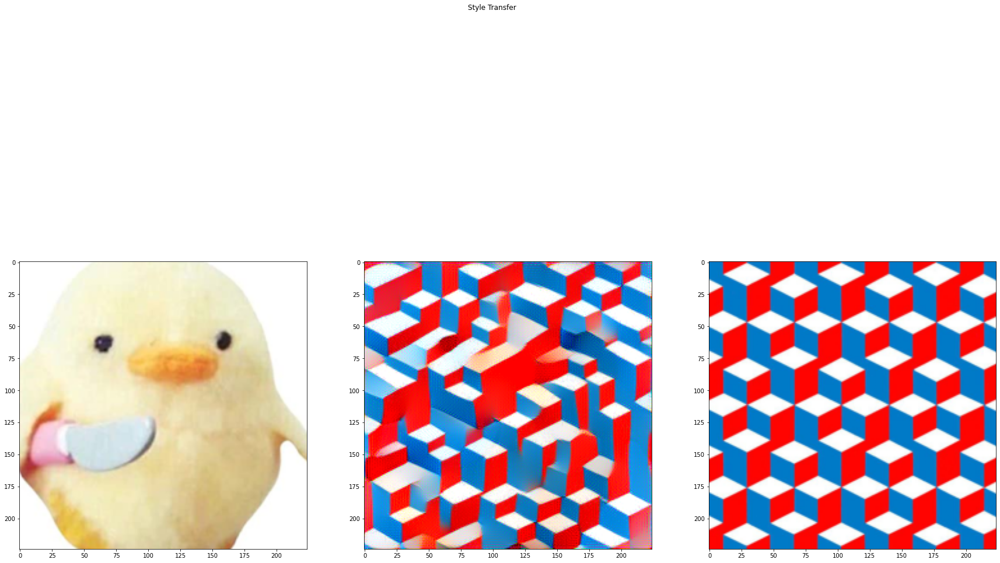

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  170


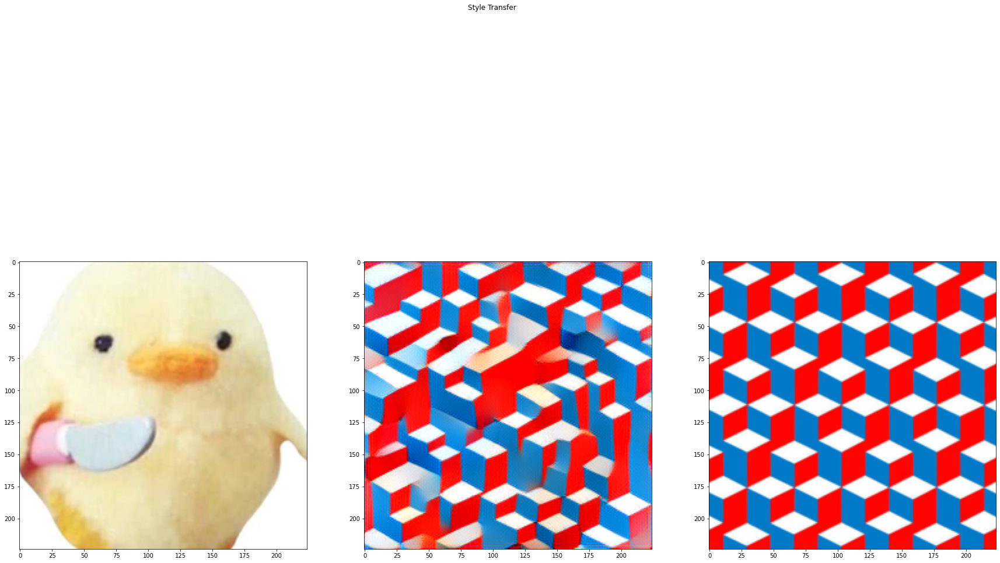

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  180


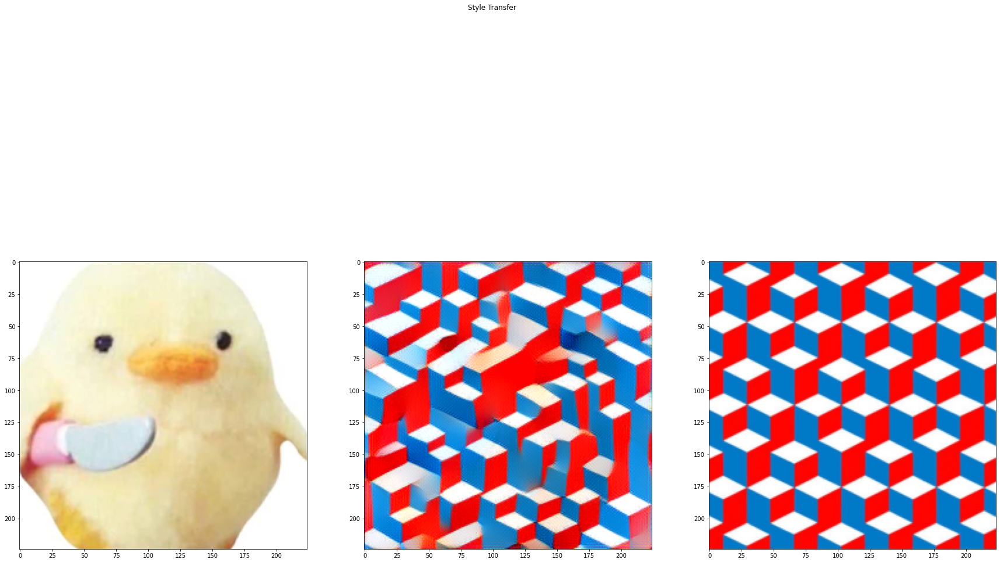

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


iteration  190


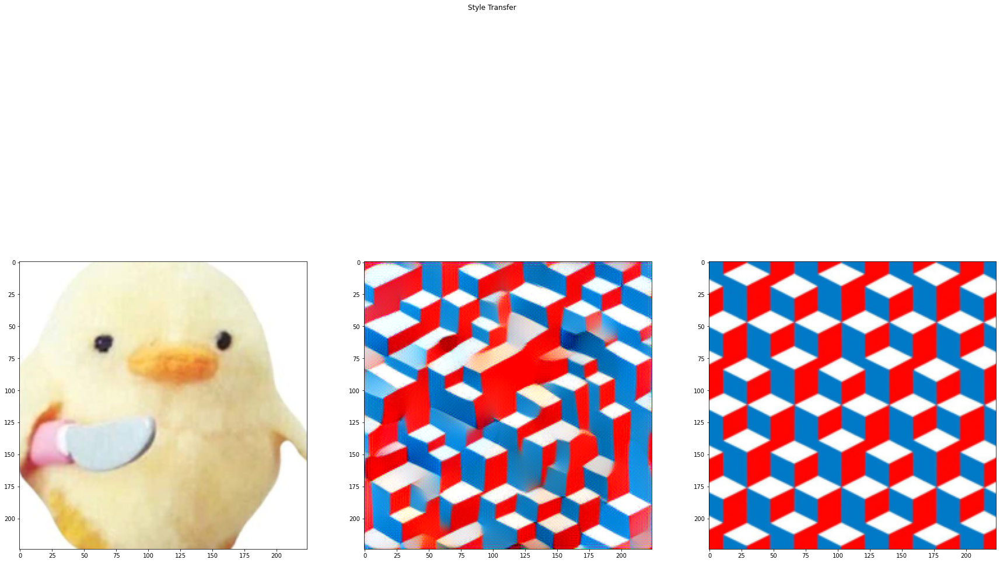

In [8]:
#content
tubingen_img = Image.open('images/Tubingen.jpg')
duck = Image.open('images/duck.jpg')
killer_duck = Image.open('images/killer_duck.png').convert('RGB')

#art 
starynight_img = Image.open('images/stary_night.jpg')
franzmarc_img = Image.open('images/franz_marc.jpg')
great_wave = Image.open('images/wave_detail.jpg')
wave = Image.open('images/wave.jpg')
pattern = Image.open('images/pattern.jpg')


def transfer_style(art_img, content_img):

    content_img = content_img
    art_img = art_img
    #get the activations
    #first we need to preprocess
    preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])

    content_img_tensor = preprocess(content_img)[None,:,:,:]
    content_img_tensor = content_img_tensor.to(device)


    art_tensor = preprocess(art_img)[None,:,:,:]
    art_tensor = art_tensor.to(device)



    model_conv1.eval()
    model_conv2.eval()
    model_conv3.eval()
    model_conv4.eval()
    model_conv5.eval()

    loss = nn.MSELoss()

    #generate white noise image x
    whitenoise_img_tensor = torch.torch.rand(content_img_tensor.shape)
    whitenoise_img_tensor = whitenoise_img_tensor.to(device)
    whitenoise_img_tensor.requires_grad=True


    def closure():
        optimizer.zero_grad()
        
        #Content
        #store the activations for layer 4
        act_p_4_cont = model_conv1(content_img_tensor)
        act_p_4_cont = act_p_4_cont.view(act_p_4_cont.shape[0],act_p_4_cont.shape[1], act_p_4_cont.shape[2]*act_p_4_cont.shape[3])
        
        act_f_4_cont = model_conv1(whitenoise_img_tensor)
        act_f_4_cont = act_f_4_cont.view(act_f_4_cont.shape[0],act_f_4_cont.shape[1], act_f_4_cont.shape[2]*act_f_4_cont.shape[3])
        
        l_content = loss(act_f_4_cont, act_p_4_cont)*torch.tensor(0.5, device=device)
        
        
        #Style
        act_a_1 = model_conv1(art_tensor)
        act_a_1 = act_a_1.view(act_a_1.shape[0],act_a_1.shape[1], act_a_1.shape[2]*act_a_1.shape[3]).squeeze()
        act_f_1 = model_conv1(whitenoise_img_tensor)
        act_f_1 = act_f_1.view(act_f_1.shape[0],act_f_1.shape[1], act_f_1.shape[2]*act_f_1.shape[3]).squeeze()
        
        act_a_2 = model_conv2(art_tensor)    
        act_a_2 = act_a_2.view(act_a_2.shape[0],act_a_2.shape[1], act_a_2.shape[2]*act_a_2.shape[3]).squeeze()
        act_f_2 = model_conv2(whitenoise_img_tensor)
        act_f_2 = act_f_2.view(act_f_2.shape[0],act_f_2.shape[1], act_f_2.shape[2]*act_f_2.shape[3]).squeeze()
        
        act_a_3 = model_conv3(art_tensor)
        act_a_3 = act_a_3.view(act_a_3.shape[0],act_a_3.shape[1], act_a_3.shape[2]*act_a_3.shape[3]).squeeze()
        act_f_3 = model_conv3(whitenoise_img_tensor)
        act_f_3 = act_f_3.view(act_f_3.shape[0],act_f_3.shape[1], act_f_3.shape[2]*act_f_3.shape[3]).squeeze()

        act_a_4 = model_conv4(art_tensor)
        act_a_4 = act_a_4.view(act_a_4.shape[0],act_a_4.shape[1], act_a_4.shape[2]*act_a_4.shape[3]).squeeze()
        act_f_4 = model_conv4(whitenoise_img_tensor)
        act_f_4 = act_f_4.view(act_f_4.shape[0],act_f_4.shape[1], act_f_4.shape[2]*act_f_4.shape[3]).squeeze()
        
        act_a_5 =  model_conv5(art_tensor)
        act_a_5 = act_a_5.view(act_a_5.shape[0],act_a_5.shape[1], act_a_5.shape[2]*act_a_5.shape[3]).squeeze()
        act_f_5 = model_conv5(whitenoise_img_tensor)
        act_f_5 = act_f_5.view(act_f_5.shape[0],act_f_5.shape[1], act_f_5.shape[2]*act_f_5.shape[3]).squeeze()
      
        #build the gram matrix for the art image and the noise image 
        ga_1 = torch.empty((act_a_1.shape[0], act_a_1.shape[0]), device=device)
        ga_2 = torch.empty((act_a_2.shape[0], act_a_2.shape[0]), device=device)
        ga_3 = torch.empty((act_a_3.shape[0], act_a_3.shape[0]), device=device)
        ga_4 = torch.empty((act_a_4.shape[0], act_a_4.shape[0]), device=device)
        ga_5 = torch.empty((act_a_5.shape[0], act_a_5.shape[0]), device=device)
        
        gf_1 = torch.empty((act_a_1.shape[0], act_a_1.shape[0]), device=device)
        gf_2 = torch.empty((act_a_2.shape[0], act_a_2.shape[0]), device=device)
        gf_3 = torch.empty((act_a_3.shape[0], act_a_3.shape[0]), device=device)
        gf_4 = torch.empty((act_a_4.shape[0], act_a_4.shape[0]), device=device)
        gf_5 = torch.empty((act_a_5.shape[0], act_a_5.shape[0]), device=device)

        #print(act_a_1.shape, act_a_2.shape, act_a_3.shape, act_a_4.shape, act_a_5.shape)
        
        tt4 = torch.tensor(4, device=device)
        
        ga_1 = torch.mm(act_a_1, act_a_1.t())# / (tt4* ga_1.shape[0]**2 *  ga_1.shape[1]**2 )
        gf_1 = torch.mm(act_f_1, act_f_1.t())# / (tt4* gf_1.shape[0]**2  *  gf_1.shape[1]**2 )
                
        ga_2 = torch.mm(act_a_2, act_a_2.t())# / (tt4* ga_2.shape[0]**2 *  ga_2.shape[1]**2 )
        gf_2 = torch.mm(act_f_2, act_f_2.t())# / (tt4* gf_2.shape[0]**2 *  gf_2.shape[1]**2 )
                
        ga_3 = torch.mm(act_a_3, act_a_3.t())# / (tt4* ga_3.shape[0]**2 *  ga_3.shape[1]**2 )
        gf_3 = torch.mm(act_f_3, act_f_3.t())# / (tt4* gf_3.shape[0]**2 *  gf_3.shape[1]**2 )
        
        ga_4 = torch.mm(act_a_4, act_a_4.t())# / (tt4* ga_4.shape[0]**2 *  ga_4.shape[1]**2 )
        gf_4 = torch.mm(act_f_4, act_f_4.t()) #/ (tt4* gf_4.shape[0]**2 *  gf_4.shape[1]**2 )
        
        ga_5 = torch.mm(act_a_5, act_a_5.t())# / (tt4* ga_5.shape[0]**2 *  ga_5.shape[1]**2 )
        gf_5 = torch.mm(act_f_5, act_f_5.t())# / (tt4* gf_5.shape[0]**2 *  gf_5.shape[1]**2 )

        
        
        w= torch.tensor(0.2, device=device)
        l_style = \
          w * loss(ga_1.unsqueeze(dim=0), gf_1.unsqueeze(dim=0)) / (tt4* ga_1.shape[0]**2 *  ga_1.shape[1]**2 ) \
        + w * loss(ga_2.unsqueeze(dim=0), gf_2.unsqueeze(dim=0)) / (tt4* ga_2.shape[0]**2 *  ga_2.shape[1]**2 ) \
        + w * loss(ga_3.unsqueeze(dim=0), gf_3.unsqueeze(dim=0)) / (tt4* ga_3.shape[0]**2 *  ga_3.shape[1]**2 ) \
        + w * loss(ga_4.unsqueeze(dim=0), gf_4.unsqueeze(dim=0)) / (tt4* ga_4.shape[0]**2 *  ga_4.shape[1]**2 ) \
        + w * loss(ga_5.unsqueeze(dim=0), gf_5.unsqueeze(dim=0)) / (tt4* ga_5.shape[0]**2 *  ga_5.shape[1]**2 )
        
        #beta = torch.tensor(1000000., device=device)
        beta = torch.tensor(10., device=device)
        l_total = l_content + (beta* l_style)
        
        l_total.backward()
            
        #print(l_style,"+",l_content,"=",l_total)

        return l_total
            
        
    optimizer = LBFGS([whitenoise_img_tensor])
    iterations = 200
    for i in range(0,iterations):
        if i % 10 == 0:
            print("iteration ",i)
        if i % 10 == 0:
            img = whitenoise_img_tensor.to('cpu').clone().detach().squeeze().permute(1,2,0).numpy()
            cont_img = content_img_tensor.to('cpu').clone().detach().squeeze().permute(1,2,0).numpy()
            art_img = art_tensor.to('cpu').clone().detach().squeeze().permute(1,2,0).numpy()

            fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(
                30,20))
            fig.suptitle('Style Transfer')
            ax1.imshow(cont_img)
            ax2.imshow(img)
            ax3.imshow(art_img)
            plt.show()
        optimizer.step(closure)


#transfer_style(franzmarc_img, killer_duck)
#transfer_style(great_wave, killer_duck)
transfer_style(pattern, killer_duck)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


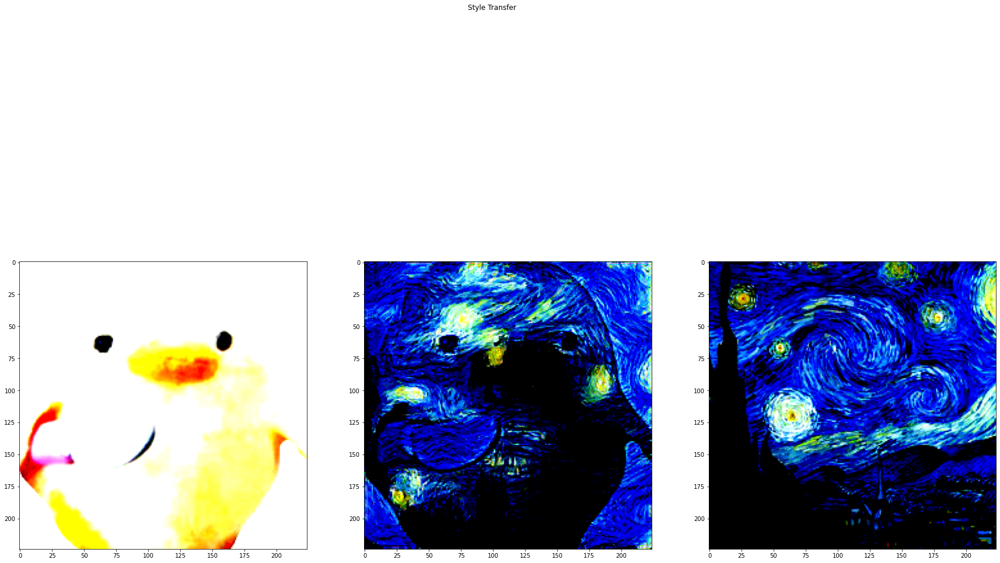

In [ ]:
img = whitenoise_img_tensor.to('cpu').clone().detach().squeeze().permute(1,2,0).numpy()
cont_img = content_img_tensor.to('cpu').clone().detach().squeeze().permute(1,2,0).numpy()
art_img = art_tensor.to('cpu').clone().detach().squeeze().permute(1,2,0).numpy()

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(
    30,20))
fig.suptitle('Style Transfer')
ax1.imshow(cont_img)
ax2.imshow(img)
ax3.imshow(art_img)
plt.show()